In [7]:
from IPython.display import Audio, display
import urllib.request
import numpy as np
import scipy.stats
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.transforms import BlendedGenericTransform
import scikit_posthocs as sp
from urllib.request import urlopen
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import librosa
import stempeg
import glob
import os
import subprocess
import os.path
from scipy.io import wavfile

In [15]:
sr, track = wavfile.read("./data/Songs/test/Al James - Schoolboy Facination/mixture16.wav")
sr

16000

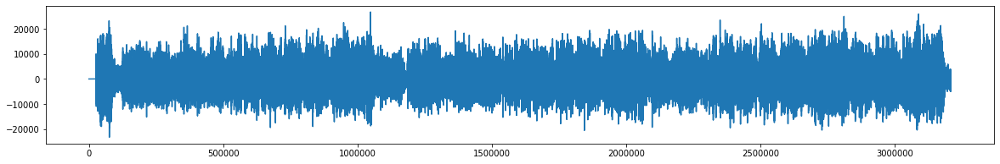

In [16]:
display(Audio(track, rate=sr))
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(track);

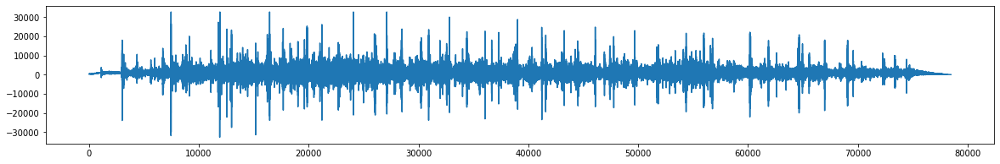

In [17]:
noise_sr, noise = wavfile.read("./data//Applause_test/app-29_16.wav")
display(Audio(noise, rate=noise_sr))
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(noise);

In [18]:
def get_tiled_noise(noise, N):
    y = noise
    while len(y) < N:
        y = np.append(y, noise)
    y = y[0:N]
    return y

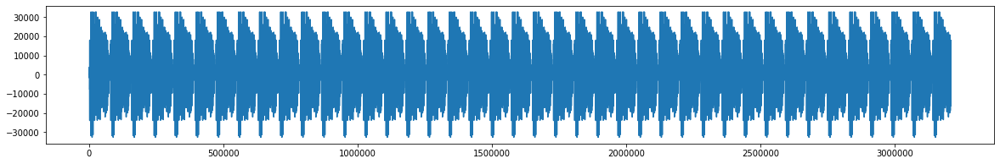

In [19]:
noise_tiled = get_tiled_noise(noise, len(track))
display(Audio(noise_tiled, rate=noise_sr))
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(noise_tiled);

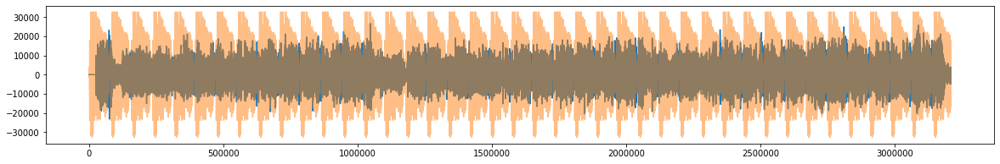

In [20]:
fig, ax = plt.subplots(figsize=(20,3))
ax.plot(track)
ax.plot(noise_tiled, alpha = 0.5);

In [21]:
def get_SNR(signal, noise):
    db_list = np.array([-3])

    signal_power = np.mean(np.square(signal))
    noise_power = np.mean(np.square(noise))
    ratio = signal_power / noise_power

    # initial SNR is 10 * np.log10(signal_power / noise_power)
    # signal to noise scale factor
    K = ratio * np.power(10, -db_list / 10)

    return K

In [22]:
snr_ratios = get_SNR(track, noise_tiled)
print(snr_ratios)
snr = np.random.choice(snr_ratios, 1)[0]
print("snr = ", snr)
# multiplied with snr with noise_tiled because we get ratios of signal/noise to fixed signal energy
mix = track + snr * noise_tiled

[1.91229039]
snr =  1.9122903880663702


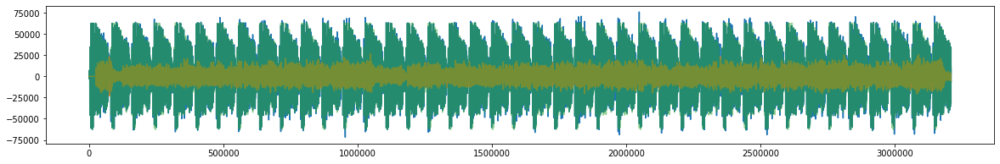

In [23]:
fig, ax = plt.subplots(figsize=(20,3))
display(Audio(mix, rate=sr))
ax.plot(mix)
ax.plot(track, alpha=0.7)
ax.plot(snr * noise_tiled, alpha = 0.5);

In [87]:
with h5py.File("data/test/h5s/AM Contra - Heart Peripheral.noisy_0.h5", 'r') as hf:
    data = hf['dataset'][:]
    mlc, phase = librosa.magphase(data)

In [103]:
with h5py.File("data/test/h5s/AM Contra - Heart Peripheral.linear_mixture_0.h5", 'r') as hf:
    data = hf['dataset'][:]
    mlc_lin, phase_lin = librosa.magphase(data)

In [145]:
inp_slice, rate = librosa.load('data/test/wavs/AM Contra - Heart Peripheral.linear_mixture_0.wav', sr=track.rate)
inp_slice = librosa.to_mono(inp_slice)
display(Audio(inp_slice.T, rate=rate))

In [146]:
ft_inp = librosa.stft(inp_slice, n_fft=2048, hop_length=512, window='hann', center=True)

In [147]:
mlc_1, phase_1 = librosa.magphase(ft_inp)

In [163]:
ist = librosa.istft(mlc_1 * phase_1)

In [164]:
display(Audio(ist.T, rate=rate))

In [207]:
for n_track, lst in enumerate(tqdm(dataloader)):
                    # TODO change source hardcoding, handle unequal size of mix and source
                    normalized_mix = lst[1].float().numpy()
                    normalized_signal = lst[0].float().numpy()
                    original_mix = lst[2].float().numpy()
                    signal = lst[3].float().numpy()

                    # Put 0.0 where values are low
                    #
                    b = np.divide(normalized_signal, normalized_mix, out=np.zeros_like(normalized_signal), where=normalized_mix!=0.0)
                    b1 = np.divide(signal, original_mix, out=np.zeros_like(signal), where=original_mix!=0.0)
                    
#                     z = b.reshape(len(b),-1).flatten()
#                     v = np.where(z == np.max(z))
#                     idx = v[0][0]
#                     print("signal value")
#                     print(normalized_signal.reshape(len(normalized_signal),-1).flatten()[idx])
#                     print(np.min(normalized_signal))
#                     print(np.max(normalized_signal))
#                     print(normalized_signal[:20])
#                     # print(signal.reshape(len(signal),-1).flatten()[idx])


#                     print("mix value")
#                     print(normalized_mix.reshape(len(normalized_mix),-1).flatten()[idx])
#                     print(np.min(normalized_mix))
#                     print(np.max(normalized_mix))
#                     print(normalized_mix[:20])
#                     # print(original_mix.reshape(len(original_mix),-1).flatten()[idx])
#                     print(np.max(z))

                    print(np.max(b))        
                    clipped = np.clip(b1, 0.0, 1.0)
                    print(np.max(clipped)) 
                    print(clipped.shape)
#                     pred_stft = original_mix * b
                    print(np.max(b1))
                    print(np.min(b1))
                    print("dfdf")
                    pred_clip_stft = original_mix *b1
                    
                    pred_song = librosa.db_to_amplitude(pred_clip_stft[0])
                    complex_arr = pred_song * phase
                    pred_song = librosa.istft(complex_arr, length=308700)

#                     signal = librosa.db_to_amplitude(signal[0])
#                     complex_arr = pred_song * phase
#                   pred_song = librosa.istft(complex_arr, length=308700)
                    break
                    
#                     pred_istft = 
#                     ax.plot(mix)
#                     ax.plot(song, alpha=0.7)
#                     ax.plot(snr * noise_tiled, alpha = 0.5);


                    break

  0%|          | 0/1 [00:00<?, ?it/s]

['data/test/h5s/AM Contra - Heart Peripheral.noisy_0.h5'
 'data/test/h5s/AM Contra - Heart Peripheral.linear_mixture_0.h5']
7683.2993
1.0
(1, 1025, 603)
421966.53
-1841270.1
dfdf


In [205]:
display(Audio(pred_song, rate=44100))

In [126]:
mlc

array([[6.4926498e+01, 6.6042984e+01, 7.2779953e+01, ..., 1.0224905e+02,
        1.0552190e+02, 1.2039498e+02],
       [3.2233715e+01, 3.2342243e+01, 3.4999817e+01, ..., 4.7950272e+01,
        5.7189991e+01, 5.1514374e+01],
       [6.4198875e-01, 7.0875442e-01, 2.1650147e+00, ..., 3.9087417e+00,
        1.4977505e+01, 2.8108215e+01],
       ...,
       [4.3116454e-02, 2.0397013e-02, 1.2800480e-03, ..., 1.6632711e-03,
        1.4749681e-02, 1.9311331e-02],
       [4.8536502e-02, 2.4397679e-02, 1.5034316e-03, ..., 3.8032960e-03,
        1.3587273e-02, 1.9643944e-02],
       [5.2635759e-02, 2.8584361e-02, 3.1460568e-03, ..., 5.4326011e-03,
        1.3311753e-02, 2.4490245e-03]], dtype=float32)